In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly as py
%matplotlib inline
import os
import pandas_profiling
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, f1_score, recall_score

In [2]:
df=pd.read_csv("Dataset.csv",low_memory=False)

In [3]:
df.head()

,sku,national_inv,lead_time,in_transit_qty,forecast_3_month,forecast_6_month,forecast_9_month,sales_1_month,sales_3_month,sales_6_month,...,pieces_past_due,perf_6_month_avg,perf_12_month_avg,local_bo_qty,deck_risk,oe_constraint,ppap_risk,stop_auto_buy,rev_stop,went_on_backorder
0,1111623,0,8.0,0,2,3,5,0,3,3,...,0,0.68,0.58,0,No,No,Yes,Yes,No,Yes
1,1111652,24,8.0,0,3456,3456,3456,10,39,68,...,0,1.00,0.95,1,No,No,Yes,Yes,No,Yes
2,1111655,-55,8.0,2,428,526,606,25,100,205,...,0,-99.00,-99.00,56,No,No,No,Yes,No,Yes
3,1111659,30,8.0,14,42,84,126,7,56,107,...,0,0.98,0.92,0,No,No,No,Yes,No,Yes
4,1111670,-499,12.0,350,3452,5044,7188,747,2550,3572,...,0,0.49,0.72,525,No,No,No,Yes,No,Yes


In [4]:
df.describe()

,sku,national_inv,lead_time,in_transit_qty,forecast_3_month,forecast_6_month,forecast_9_month,sales_1_month,sales_3_month,sales_6_month,sales_9_month,min_bank,pieces_past_due,perf_6_month_avg,perf_12_month_avg,local_bo_qty
count,1.187670e+05,1.187670e+05,110627.000000,118767.000000,1.187670e+05,1.187670e+05,1.187670e+05,118767.000000,1.187670e+05,1.187670e+05,1.187670e+05,118767.000000,118767.000000,118767.000000,118767.000000,118767.000000
mean,1.911054e+06,3.869577e+02,7.645096,52.164229,2.599210e+02,4.855791e+02,7.070231e+02,72.955771,2.283675e+02,4.377663e+02,6.680558e+02,63.028720,13.604276,-7.794247,-7.338927,1.163337
std,6.314430e+05,8.157252e+03,6.667494,1101.448088,6.105767e+03,1.198742e+04,1.790256e+04,2657.882984,6.016469e+03,1.078787e+04,1.619344e+04,1187.425934,652.593739,27.937519,27.244237,36.995913
min,1.111623e+06,-4.573000e+03,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,-99.000000,-99.000000,0.000000
25%,1.379804e+06,3.000000e+00,4.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.580000,0.600000,0.000000
50%,1.476125e+06,1.300000e+01,8.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,2.000000e+00,3.000000e+00,5.000000e+00,0.000000,0.000000,0.790000,0.780000,0.000000
75%,2.305438e+06,7.300000e+01,8.000000,0.000000,1.200000e+01,2.700000e+01,4.100000e+01,6.000000,2.100000e+01,4.100000e+01,6.300000e+01,5.000000,0.000000,0.950000,0.940000,0.000000
max,3.284914e+06,1.303177e+06,52.000000,175488.000000,1.218328e+06,2.461360e+06,3.777304e+06,741762.000000,1.070623e+06,2.146625e+06,3.197338e+06,204803.000000,137625.000000,1.000000,1.000000,4091.000000


In [5]:
df.shape

(118767, 23)

In [6]:
df.isna().sum()

sku                     0
national_inv            0
lead_time            8140
in_transit_qty          0
forecast_3_month        0
forecast_6_month        0
forecast_9_month        0
sales_1_month           0
sales_3_month           0
sales_6_month           0
sales_9_month           0
min_bank                0
potential_issue         0
pieces_past_due         0
perf_6_month_avg        0
perf_12_month_avg       0
local_bo_qty            0
deck_risk               0
oe_constraint           0
ppap_risk               0
stop_auto_buy           0
rev_stop                0
went_on_backorder       0
dtype: int64

In [7]:
df.isnull()

,sku,national_inv,lead_time,in_transit_qty,forecast_3_month,forecast_6_month,forecast_9_month,sales_1_month,sales_3_month,sales_6_month,...,pieces_past_due,perf_6_month_avg,perf_12_month_avg,local_bo_qty,deck_risk,oe_constraint,ppap_risk,stop_auto_buy,rev_stop,went_on_backorder
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
118762,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
118763,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
118764,False,False,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
118765,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


<AxesSubplot:>

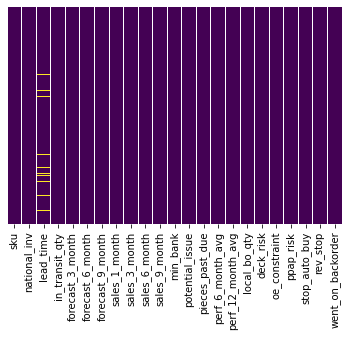

In [8]:
sns.heatmap(df.isnull(), yticklabels=False, cbar=False, cmap='viridis')

In [9]:
df.dropna(axis=0, inplace=True)
df.head()

,sku,national_inv,lead_time,in_transit_qty,forecast_3_month,forecast_6_month,forecast_9_month,sales_1_month,sales_3_month,sales_6_month,...,pieces_past_due,perf_6_month_avg,perf_12_month_avg,local_bo_qty,deck_risk,oe_constraint,ppap_risk,stop_auto_buy,rev_stop,went_on_backorder
0,1111623,0,8.0,0,2,3,5,0,3,3,...,0,0.68,0.58,0,No,No,Yes,Yes,No,Yes
1,1111652,24,8.0,0,3456,3456,3456,10,39,68,...,0,1.00,0.95,1,No,No,Yes,Yes,No,Yes
2,1111655,-55,8.0,2,428,526,606,25,100,205,...,0,-99.00,-99.00,56,No,No,No,Yes,No,Yes
3,1111659,30,8.0,14,42,84,126,7,56,107,...,0,0.98,0.92,0,No,No,No,Yes,No,Yes
4,1111670,-499,12.0,350,3452,5044,7188,747,2550,3572,...,0,0.49,0.72,525,No,No,No,Yes,No,Yes


<AxesSubplot:>

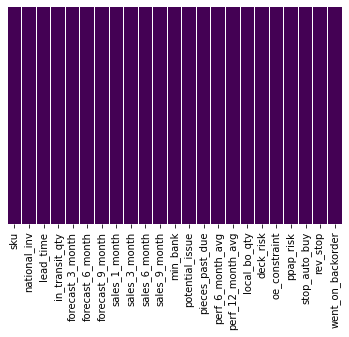

In [10]:
sns.heatmap(df.isnull(), yticklabels=False, cbar=False, cmap='viridis')

In [11]:
df.profile_report()

Summarize dataset:   0%|          | 0/37 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

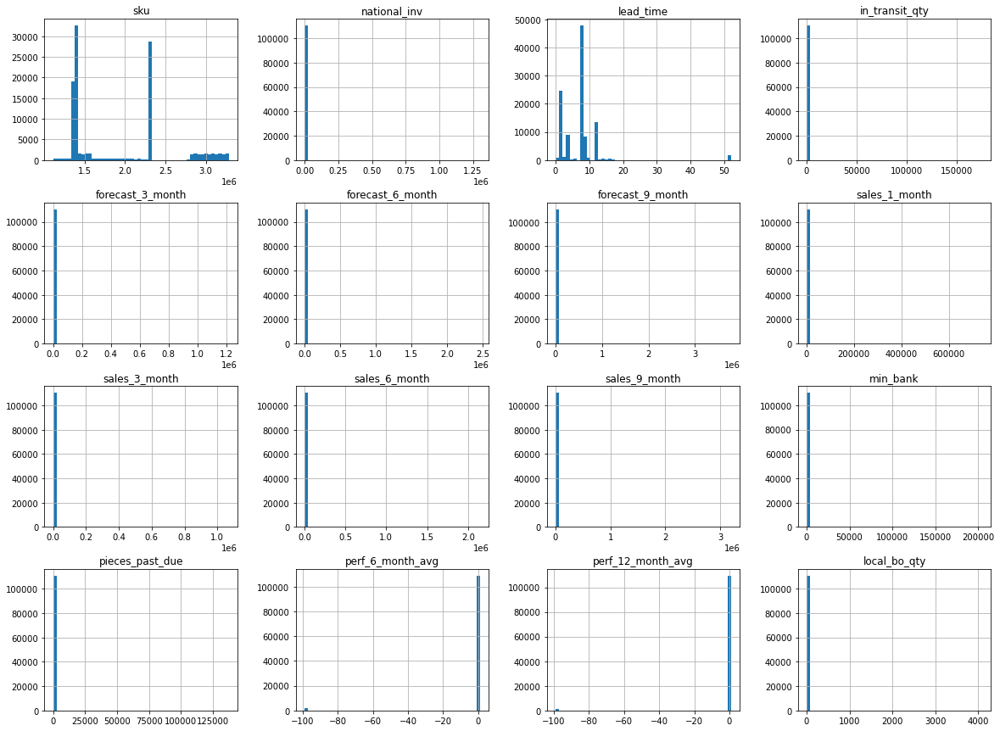

In [12]:
df.hist(bins=50, figsize=(20,15))
plt.show()

In [13]:
new_df = df.drop(['sku'], axis=1)
print(new_df.head())

   national_inv  lead_time  in_transit_qty  forecast_3_month  \
0             0        8.0               0                 2   
1            24        8.0               0              3456   
2           -55        8.0               2               428   
3            30        8.0              14                42   
4          -499       12.0             350              3452   

   forecast_6_month  forecast_9_month  sales_1_month  sales_3_month  \
0                 3                 5              0              3   
1              3456              3456             10             39   
2               526               606             25            100   
3                84               126              7             56   
4              5044              7188            747           2550   

   sales_6_month  sales_9_month  ...  pieces_past_due perf_6_month_avg  \
0              3              3  ...                0             0.68   
1             68             93  ...    

In [14]:
print(new_df.went_on_backorder.value_counts()['Yes'])
print(new_df.went_on_backorder.value_counts()['No'])

8648
101979


In [15]:
new_df_dummies = pd.get_dummies(new_df[['potential_issue','deck_risk','oe_constraint','ppap_risk','stop_auto_buy','rev_stop']])
print(new_df_dummies.head())

   potential_issue_No  potential_issue_Yes  deck_risk_No  deck_risk_Yes  \
0                   1                    0             1              0   
1                   1                    0             1              0   
2                   1                    0             1              0   
3                   1                    0             1              0   
4                   1                    0             1              0   

   oe_constraint_No  oe_constraint_Yes  ppap_risk_No  ppap_risk_Yes  \
0                 1                  0             0              1   
1                 1                  0             0              1   
2                 1                  0             1              0   
3                 1                  0             1              0   
4                 1                  0             1              0   

   stop_auto_buy_No  stop_auto_buy_Yes  rev_stop_No  rev_stop_Yes  
0                 0                  1            1   

In [16]:
latest_new_df = new_df.drop(['potential_issue','deck_risk','oe_constraint','ppap_risk','stop_auto_buy','rev_stop'],axis=1)

In [17]:
new_df_with_dummies = pd.concat((latest_new_df,new_df_dummies),axis=1)
new_df_with_dummies.head()

,national_inv,lead_time,in_transit_qty,forecast_3_month,forecast_6_month,forecast_9_month,sales_1_month,sales_3_month,sales_6_month,sales_9_month,...,deck_risk_No,deck_risk_Yes,oe_constraint_No,oe_constraint_Yes,ppap_risk_No,ppap_risk_Yes,stop_auto_buy_No,stop_auto_buy_Yes,rev_stop_No,rev_stop_Yes
0,0,8.0,0,2,3,5,0,3,3,3,...,1,0,1,0,0,1,0,1,1,0
1,24,8.0,0,3456,3456,3456,10,39,68,93,...,1,0,1,0,0,1,0,1,1,0
2,-55,8.0,2,428,526,606,25,100,205,387,...,1,0,1,0,1,0,0,1,1,0
3,30,8.0,14,42,84,126,7,56,107,148,...,1,0,1,0,1,0,0,1,1,0
4,-499,12.0,350,3452,5044,7188,747,2550,3572,4745,...,1,0,1,0,1,0,0,1,1,0


In [18]:
label_column = new_df_with_dummies['went_on_backorder']
new_df_with_dummies.drop(['went_on_backorder'], axis=1, inplace=True)
new_df_with_dummies.insert(25,'went_on_backorder',label_column)
print(new_df_with_dummies.head())

   national_inv  lead_time  in_transit_qty  forecast_3_month  \
0             0        8.0               0                 2   
1            24        8.0               0              3456   
2           -55        8.0               2               428   
3            30        8.0              14                42   
4          -499       12.0             350              3452   

   forecast_6_month  forecast_9_month  sales_1_month  sales_3_month  \
0                 3                 5              0              3   
1              3456              3456             10             39   
2               526               606             25            100   
3                84               126              7             56   
4              5044              7188            747           2550   

   sales_6_month  sales_9_month  ...  deck_risk_Yes  oe_constraint_No  \
0              3              3  ...              0                 1   
1             68             93  ...      

In [19]:
df_train, df_test = train_test_split(new_df_with_dummies, test_size=0.2)

In [20]:
x_train = df_train.drop(['went_on_backorder'], axis=1)
y_train = df_train['went_on_backorder']

x_test = df_test.drop(['went_on_backorder'], axis=1)
y_test = df_test['went_on_backorder']

In [21]:
pipe = Pipeline([
                 ("scale", StandardScaler()),
                 ("model", KNeighborsClassifier(n_neighbors=3))
])

In [22]:
pipe.get_params()

{'memory': None,
 'steps': [('scale', StandardScaler()),
  ('model', KNeighborsClassifier(n_neighbors=3))],
 'verbose': False,
 'scale': StandardScaler(),
 'model': KNeighborsClassifier(n_neighbors=3),
 'scale__copy': True,
 'scale__with_mean': True,
 'scale__with_std': True,
 'model__algorithm': 'auto',
 'model__leaf_size': 30,
 'model__metric': 'minkowski',
 'model__metric_params': None,
 'model__n_jobs': None,
 'model__n_neighbors': 3,
 'model__p': 2,
 'model__weights': 'uniform'}

In [23]:
model = GridSearchCV(estimator=pipe,param_grid={'model__n_neighbors': [1,2,3,4,5,6,7,8,9,10]},cv=3)

In [24]:
model.fit(x_train,y_train)

GridSearchCV(cv=3,
             estimator=Pipeline(steps=[('scale', StandardScaler()),
                                       ('model',
                                        KNeighborsClassifier(n_neighbors=3))]),
             param_grid={'model__n_neighbors': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]})

In [25]:
model.predict(x_test)

array(['No', 'No', 'No', ..., 'No', 'No', 'Yes'], dtype=object)

In [26]:
y_predicted = model.predict(x_test)

In [27]:
accuracy_score(y_test, y_predicted)

0.942917834222182

In [1]:
import joblib
pickle_out= open("model.pkl","wb")
pickle.dump(model, pickle_out)
pickle_out.close()


In [ ]:
# joblib_out=open("model_jbl","wb")
# joblib.dump()